# Неделя 4: нейронные сети

## Автоэнкодер для очистки изображений от шумов / Denoising Autoencoder 

0. Визуализируй сеть, которая задана в стиле `keras` на сайте [NN SVG](https://alexlenail.me/NN-SVG/index.html), сохрани изображение и вставь его в ноутбук в ячейку ниже: `![](img.svg)`

```
model = model.Sequential([
    Conv2D(32),
    Conv2D(16),
    Dense(2),
    Dense(5),
    Dense(10)
    ])
```
    


> картинка тут

В задании необходимо обучить автоэнкодер для очискти изображений документов от шумов. 

Ссылка на соревнование на `kaggle`: https://www.kaggle.com/c/denoising-dirty-documents/data

1. Импортируй библиотеки для создания нейросети и визуализации изображений. 

In [93]:
from torch.utils.data import Dataset, DataLoader
import os
import pandas as pd
import matplotlib.pyplot as plt
from torchvision.io import read_image
from torchvision import transforms as T
import torch
from torchvision.io import ImageReadMode

In [105]:
preprocessing = T.Compose(
    [
        T.ToPILImage(),
        T.Grayscale(),
        T.Resize((128, 128)), # <------ свой размер        
        T.ToTensor()
    ]
)

class CustomImageDataset(Dataset):
    def __init__(self, noise_dir, clean_dir, aug=None):
        self.noise_dir = noise_dir
        self.clean_dir = clean_dir
        self.noise_names = sorted(os.listdir(noise_dir))
        self.clean_names = sorted(os.listdir(clean_dir))
        self.aug = aug
    def __len__(self):
        return len(self.noise_names)
    


    def __getitem__(self, idx):
        noisy_img = read_image(os.path.join(self.noise_dir, self.noise_names[idx])) #, mode = ImageReadMode.GRAY))
        clean_img = read_image(os.path.join(self.clean_dir, self.clean_names[idx])) #, mode = ImageReadMode.GRAY))
        if self.aug:
            noisy_img = self.aug(noisy_img)
            clean_img = self.aug(clean_img)
        return noisy_img, clean_img

In [106]:
train = '/home/petrucho/ds_offline/learning/10-nn/data/denoising-dirty-documents/train'
train_cleaned = '/home/petrucho/ds_offline/learning/10-nn/data/denoising-dirty-documents/train_cleaned'

In [107]:
ae_dataset = CustomImageDataset(train, train_cleaned, aug=preprocessing)

2. Загрузи данные для решения задачи.

In [108]:
loader = DataLoader(ae_dataset, batch_size=32)

In [89]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

cuda


3. Распечатай один и тот же документ в двух версиях: зашумленной и очищенной. 

In [109]:
noisy_batch, clean_batch = next(iter(loader))

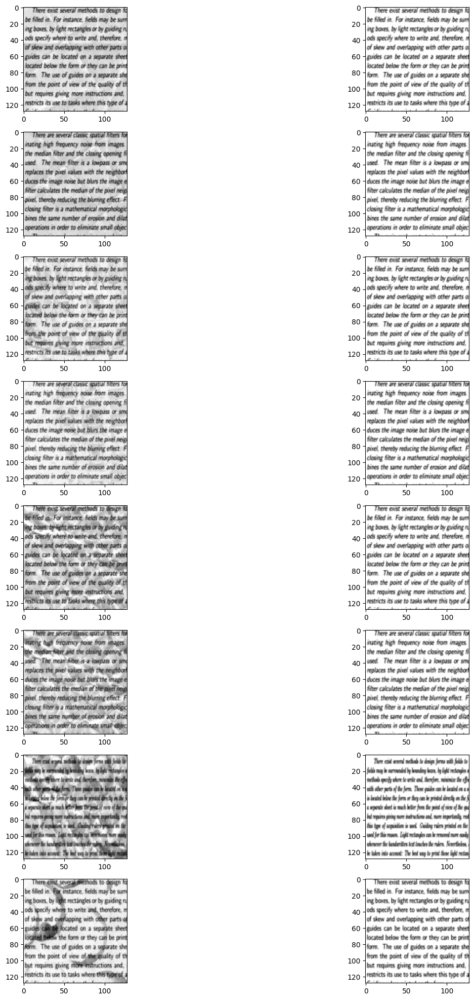

In [99]:
fig, ax = plt.subplots(8, 2, figsize=(16, 25))


for i in range(8):
    ax[i, 0].imshow(noisy_batch[i].squeeze(0), cmap='gray')
    ax[i, 1].imshow(clean_batch[i].squeeze(0), cmap='gray')

4. Подготовь данные для обучения. Если будешь использовать библиотеку `keras`, то воспользуйся функцией `to_arrays`, если собираешься использовать `pyTorсh`, можно обойтись встроенным `ImageFolder` + `DataLoader`

In [ ]:
# CELL FOR KERAS
from tensorflow.keras.preprocessing.image import img_to_array, load_img


width=420
height=540

def to_arrays(path, width=width, height=height):
    '''
    path: str 'data/train', 'data/test', etc
    '''
    array = []
    
    files = os.listdir(path)
    
    for i in files:
        # загружаем изображения, сразу изменяем размер и переводим в одноканальный формат
        img = load_img(f'{path + "/" + i}', target_size=(width, height), color_mode='grayscale')
        
        # преобразовываем изображение в матрицу и сразу нормируем на 255
        img = img_to_array(img, dtype='float32')/255.
        # собираем все в один список 
        array.append(img)
        
        # возвращаем np.array
    return np.array(array)

x_train = create_array_set('denoise/train/')
x_train_cleaned = create_array_set('denoise/train_cleaned/')
x_test = create_array_set('denoise/test/')

5. Распечатай `shape` получившихся наборов данных.  

In [100]:
print(noisy_batch.shape)
print(clean_batch.shape)

torch.Size([32, 1, 128, 128])
torch.Size([32, 1, 128, 128])


6. Задай сверточный энкодер. 

In [12]:
import torch.nn as nn
from torchsummary import summary

In [73]:
class ConvEncoder(nn.Module):
    def __init__(self):
        super().__init__()
        # encoder 
        self.conv1 = nn.Sequential(
            nn.Conv2d(1, 32, kernel_size=3, padding=1),
            nn.LazyBatchNorm2d(),
            nn.SELU()
            )
        self.conv2 = nn.Sequential(
            nn.Conv2d(32, 16, kernel_size=3, padding=1),
            nn.LazyBatchNorm2d(),
            nn.SELU()
            )
        self.conv3 = nn.Sequential(
            nn.Conv2d(16, 4, kernel_size=3, padding=1),
            nn.LazyBatchNorm2d(),
            nn.SELU()
            )
        
        self.pool = nn.MaxPool2d(2, 2, return_indices=True)
                

    def forward(self, x):
        # encode
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x, indicies = self.pool(x) # ⟸ bottleneck

        # print(x.shape)
        

        return x, indicies


7. Прогони через него (для этого можно не обучать) одно изображение и распечатай `shape` латентного пространства. 

In [75]:
model_encode = ConvEncoder().to(device)
summary(model_encode, (1, 128, 128), batch_size=1)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [1, 32, 128, 128]             320
       BatchNorm2d-2          [1, 32, 128, 128]              64
              SELU-3          [1, 32, 128, 128]               0
            Conv2d-4          [1, 16, 128, 128]           4,624
       BatchNorm2d-5          [1, 16, 128, 128]              32
              SELU-6          [1, 16, 128, 128]               0
            Conv2d-7           [1, 4, 128, 128]             580
       BatchNorm2d-8           [1, 4, 128, 128]               8
              SELU-9           [1, 4, 128, 128]               0
        MaxPool2d-10  [[-1, 4, 64, 64], [-1, 4, 64, 64]]               0
Total params: 5,628
Trainable params: 5,628
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.06
Forward/backward pass size (MB): 2067.50
Params size (MB): 0.02
Est

8. Задай сверточный декодер (помни, что выходная размерность должна соответствовать размерности исходной картинки). 

In [77]:
class ConvDecoder(nn.Module):
    def __init__(self):
        super().__init__()        
        #decoder
        # Как работает Conv2dTranspose https://github.com/vdumoulin/conv_arithmetic        
        
        self.unpool = nn.MaxUnpool2d(2, 2)
        
        self.conv1_t = nn.Sequential(
            nn.ConvTranspose2d(4, 16, kernel_size=3, padding=1),
            nn.LazyBatchNorm2d(),
            nn.SELU()
            )
        self.conv2_t = nn.Sequential(
            nn.ConvTranspose2d(16, 32, kernel_size=3, padding=1),
            nn.LazyBatchNorm2d(),
            nn.SELU()
            )
        self.conv3_t = nn.Sequential(
            nn.Conv2d(32, 1, kernel_size=3,padding=1),
            nn.LazyBatchNorm2d(),
            nn.SELU()
            )

        

    def forward(self, x, indicies_for_decoder):                
        # decode
        x = self.unpool(x, indicies_for_decoder)
        x = self.conv1_t(x)
        x = self.conv2_t(x)
        x = self.conv3_t(x)

        return x

In [78]:
class Autoencoder(nn.Module):
    def __init__(self):
        super().__init__()
        self.encoder = ConvEncoder()
        self.decoder = ConvDecoder()

    def forward(self, x):
        x, indicies = self.encoder(x)
        out = self.decoder(x, indicies)
        return out

9. Проверь размерность выхода декодера.

In [79]:
model = Autoencoder().to(device)
summary(model, (1, 128, 128), batch_size=1)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [1, 32, 128, 128]             320
       BatchNorm2d-2          [1, 32, 128, 128]              64
              SELU-3          [1, 32, 128, 128]               0
            Conv2d-4          [1, 16, 128, 128]           4,624
       BatchNorm2d-5          [1, 16, 128, 128]              32
              SELU-6          [1, 16, 128, 128]               0
            Conv2d-7           [1, 4, 128, 128]             580
       BatchNorm2d-8           [1, 4, 128, 128]               8
              SELU-9           [1, 4, 128, 128]               0
        MaxPool2d-10  [[-1, 4, 64, 64], [-1, 4, 64, 64]]               0
      ConvEncoder-11  [[-1, 4, 64, 64], [-1, 4, 64, 64]]               0
      MaxUnpool2d-12           [1, 4, 128, 128]               0
  ConvTranspose2d-13          [1, 16, 128, 128]             592
      BatchNorm2d-14 

10. Обучи автоэнкодер. В процессе обучения собирай значения лосса и метрики (например, mse), распечатай их после окончания обучения. 

In [36]:
from torchvision import transforms

In [80]:
#Loss function
criterion = nn.MSELoss()

#Optimizer
optimizer = torch.optim.SGD(model.parameters(), lr=0.03)

lr_sched = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=5, eta_min=0.05)

In [68]:
from torchvision.utils import save_image

In [69]:
import time

In [ ]:
#  now = time.strftime("%H:%M", time.localtime(time.time()))
#  print("the now time is ") + str(now)


------------- Epoch 1 -------------
Epoch: 1 	Training Loss: 0.023601 	lr:0.043


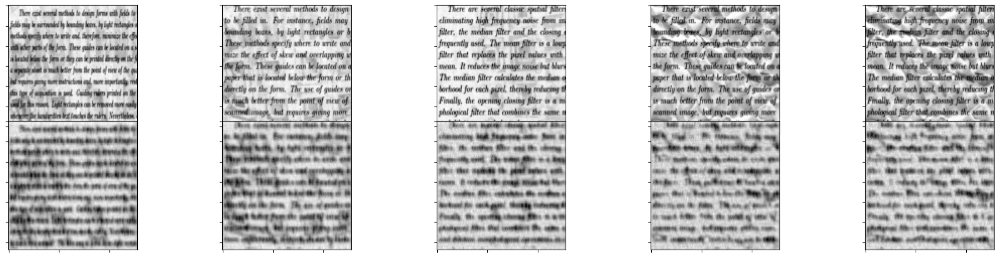


------------- Epoch 2 -------------
Epoch: 2 	Training Loss: 0.023427 	lr:0.037


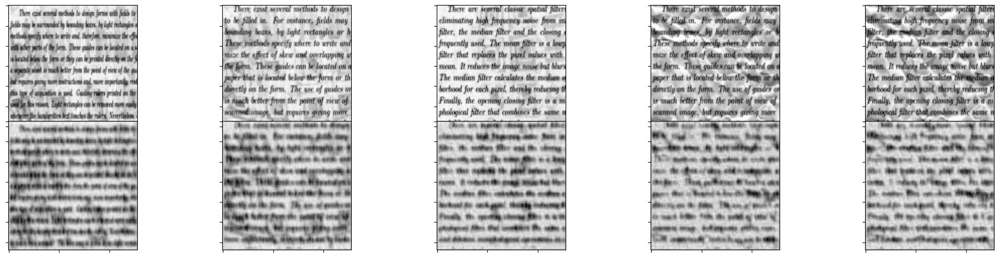


------------- Epoch 3 -------------
Epoch: 3 	Training Loss: 0.023228 	lr:0.043


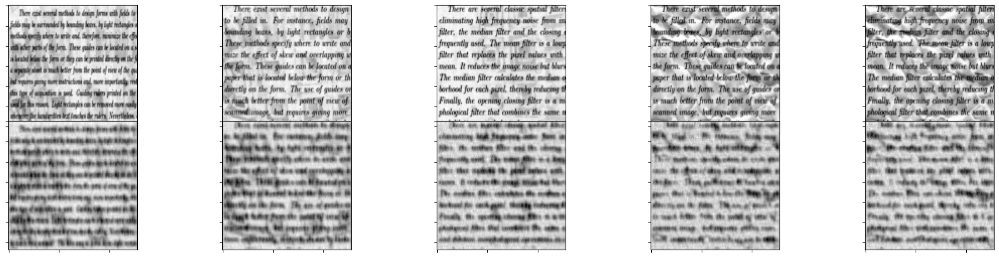


------------- Epoch 4 -------------
Epoch: 4 	Training Loss: 0.023063 	lr:0.037


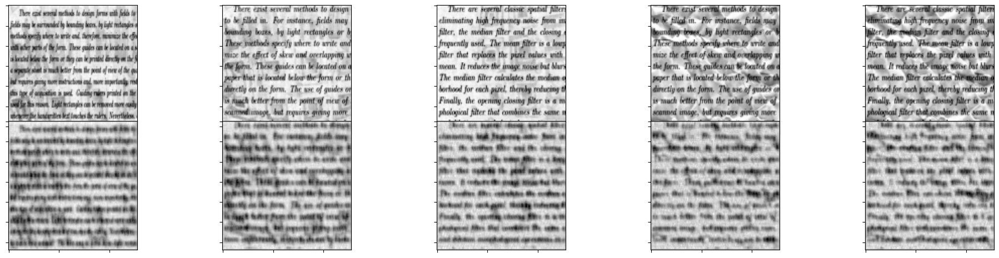


------------- Epoch 5 -------------
Epoch: 5 	Training Loss: 0.022876 	lr:0.043


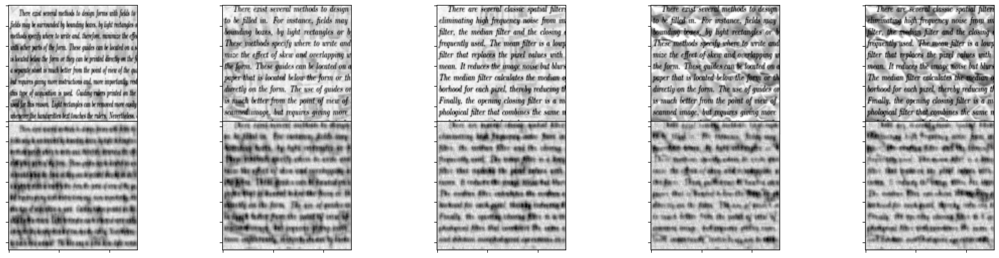


------------- Epoch 6 -------------
Epoch: 6 	Training Loss: 0.022722 	lr:0.037


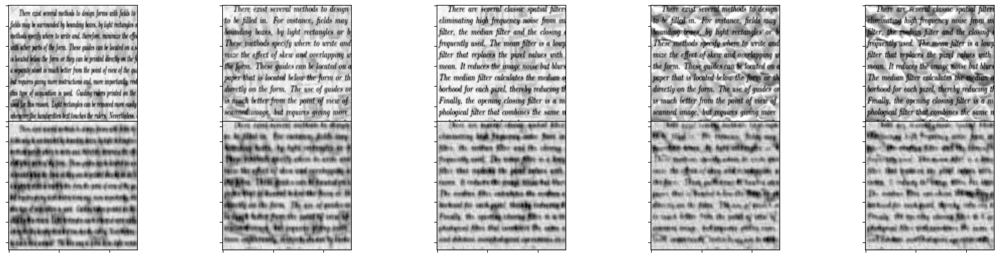


------------- Epoch 7 -------------
Epoch: 7 	Training Loss: 0.022547 	lr:0.043


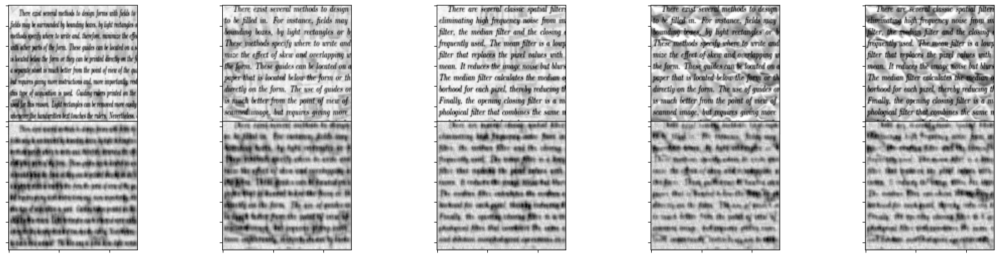


------------- Epoch 8 -------------
Epoch: 8 	Training Loss: 0.022402 	lr:0.037


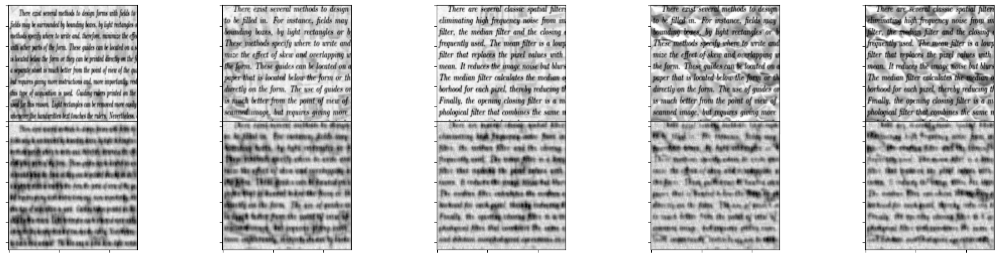


------------- Epoch 9 -------------
Epoch: 9 	Training Loss: 0.022238 	lr:0.043


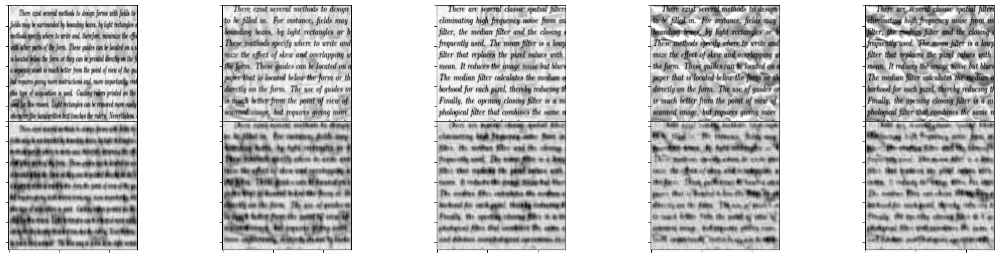


------------- Epoch 10 -------------
Epoch: 10 	Training Loss: 0.022103 	lr:0.037


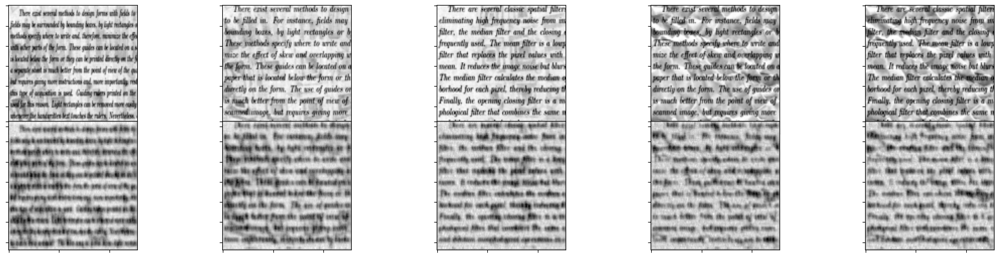


------------- Epoch 11 -------------
Epoch: 11 	Training Loss: 0.021950 	lr:0.043


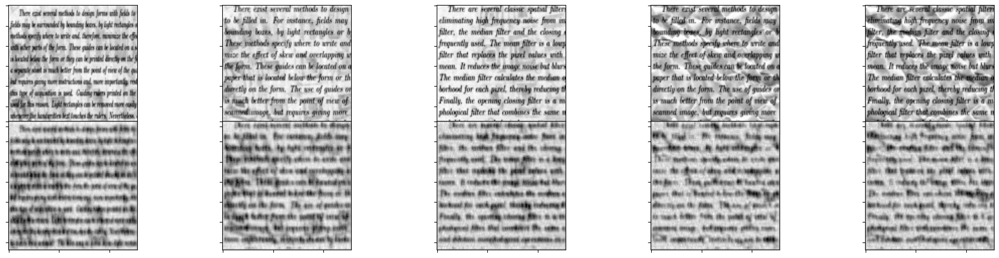


------------- Epoch 12 -------------
Epoch: 12 	Training Loss: 0.021824 	lr:0.037


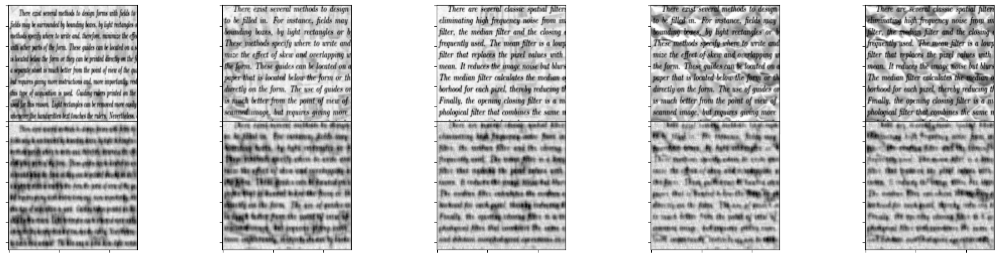


------------- Epoch 13 -------------
Epoch: 13 	Training Loss: 0.021678 	lr:0.043


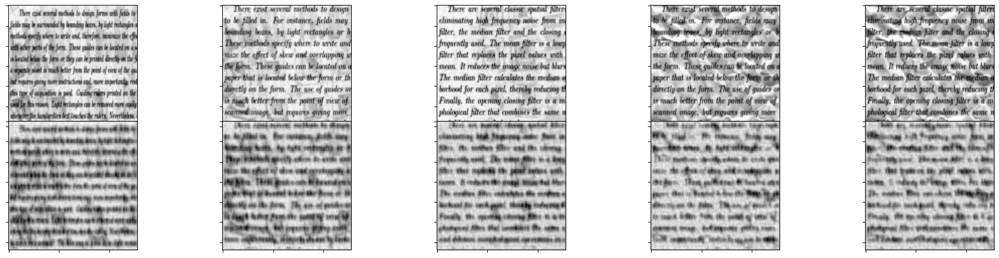


------------- Epoch 14 -------------
Epoch: 14 	Training Loss: 0.021561 	lr:0.037


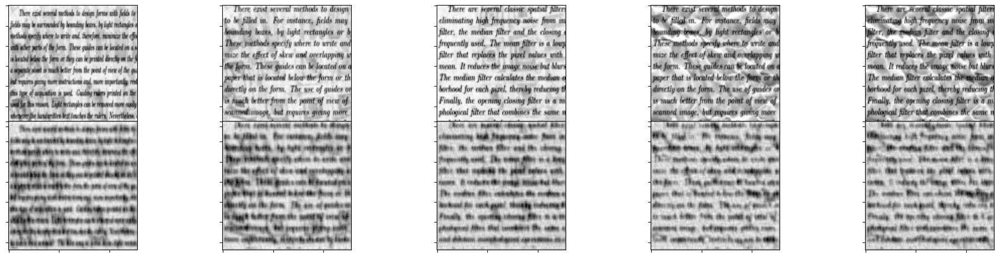


------------- Epoch 15 -------------
Epoch: 15 	Training Loss: 0.021425 	lr:0.043


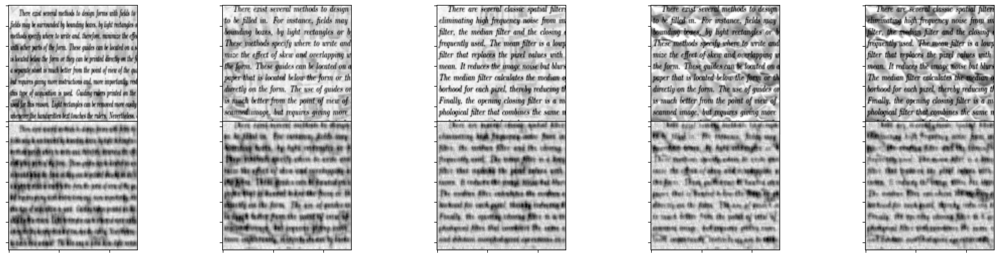


------------- Epoch 16 -------------
Epoch: 16 	Training Loss: 0.021316 	lr:0.037


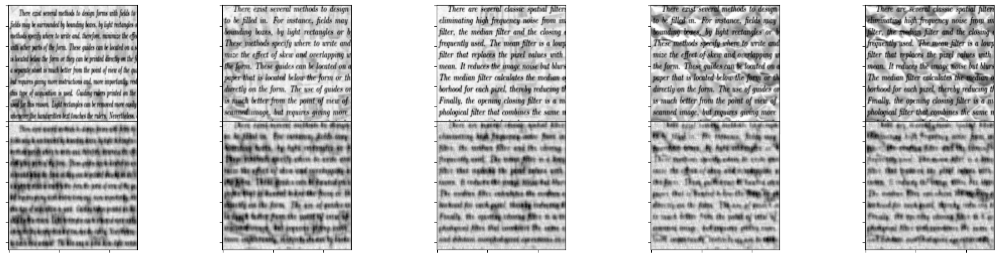


------------- Epoch 17 -------------
Epoch: 17 	Training Loss: 0.021188 	lr:0.043


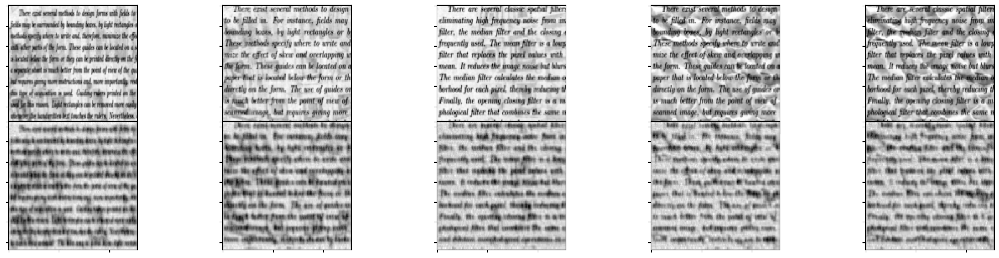


------------- Epoch 18 -------------
Epoch: 18 	Training Loss: 0.021085 	lr:0.037


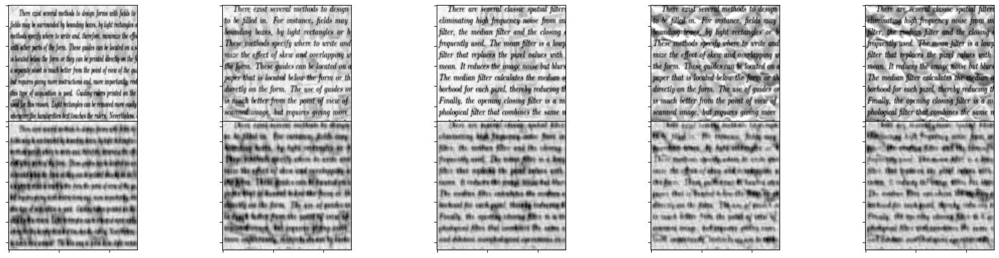


------------- Epoch 19 -------------
Epoch: 19 	Training Loss: 0.020963 	lr:0.043


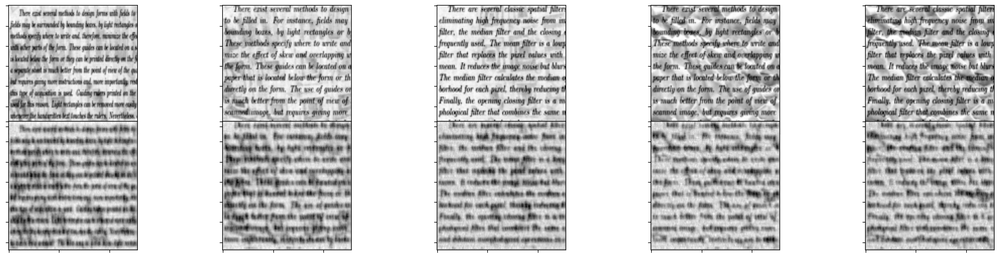


------------- Epoch 20 -------------
Epoch: 20 	Training Loss: 0.020865 	lr:0.037


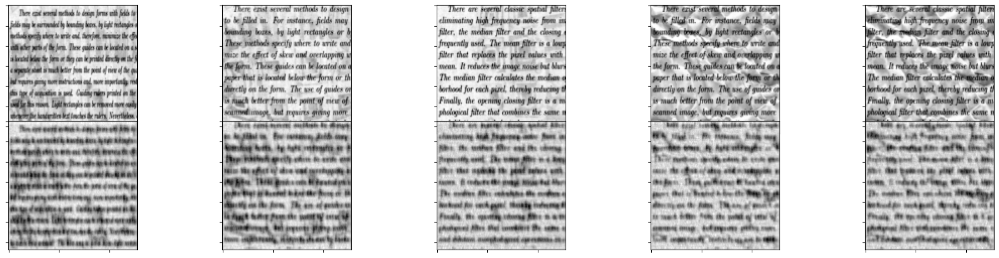


------------- Epoch 21 -------------
Epoch: 21 	Training Loss: 0.020752 	lr:0.043


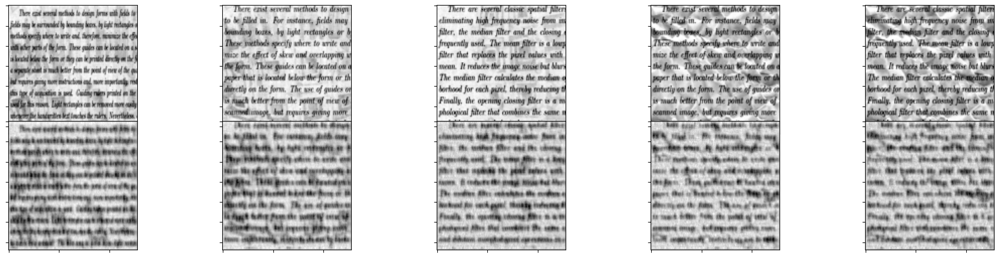


------------- Epoch 22 -------------
Epoch: 22 	Training Loss: 0.020661 	lr:0.037


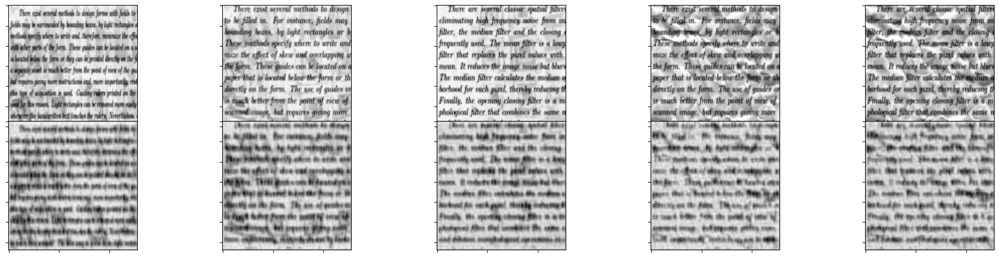


------------- Epoch 23 -------------
Epoch: 23 	Training Loss: 0.020551 	lr:0.043


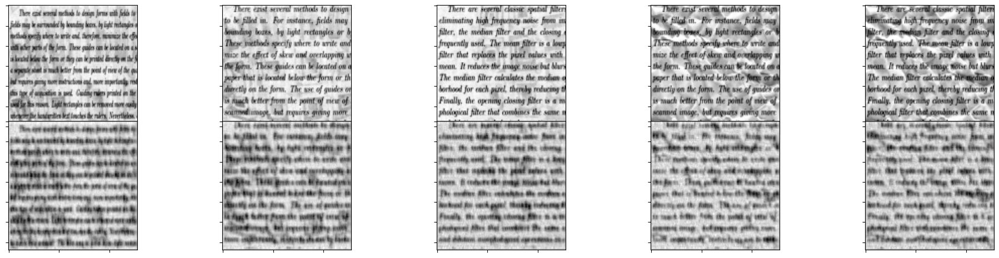


------------- Epoch 24 -------------
Epoch: 24 	Training Loss: 0.020466 	lr:0.037


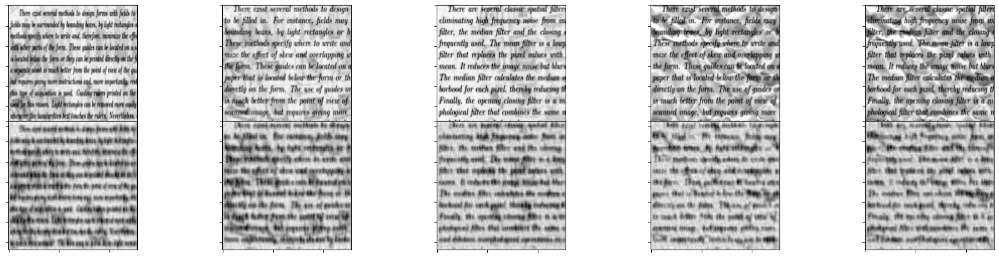


------------- Epoch 25 -------------
Epoch: 25 	Training Loss: 0.020359 	lr:0.043


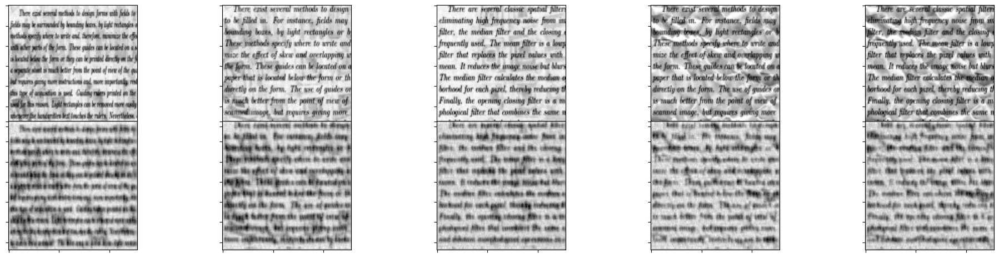


------------- Epoch 26 -------------
Epoch: 26 	Training Loss: 0.020275 	lr:0.037


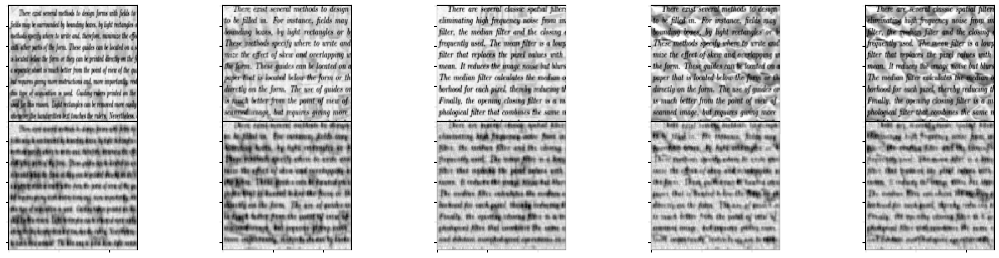


------------- Epoch 27 -------------
Epoch: 27 	Training Loss: 0.020173 	lr:0.043


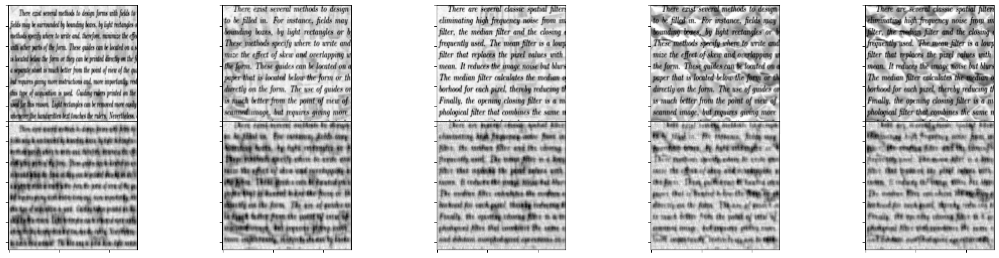


------------- Epoch 28 -------------
Epoch: 28 	Training Loss: 0.020094 	lr:0.037


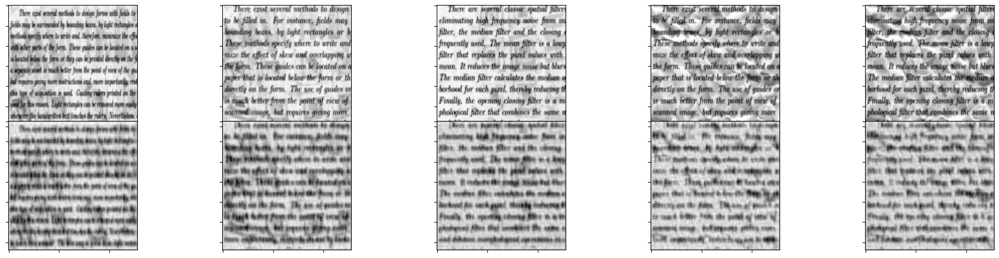


------------- Epoch 29 -------------
Epoch: 29 	Training Loss: 0.019997 	lr:0.043


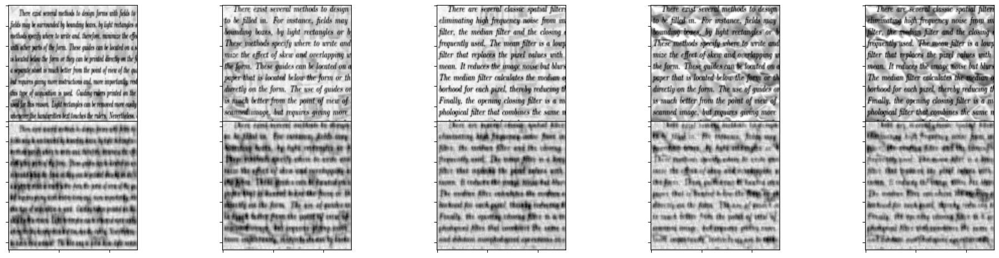


------------- Epoch 30 -------------
Epoch: 30 	Training Loss: 0.019921 	lr:0.037


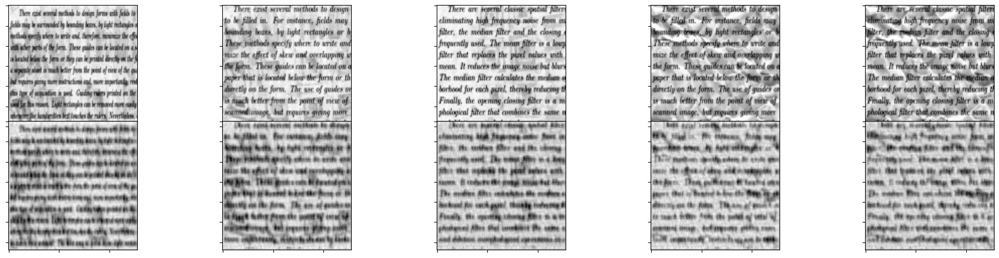


------------- Epoch 31 -------------
Epoch: 31 	Training Loss: 0.019827 	lr:0.043


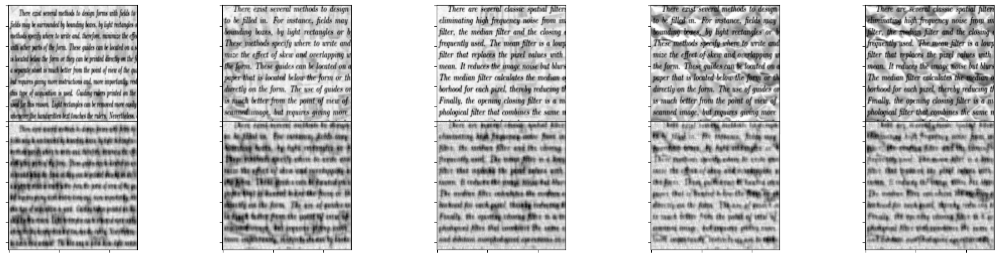


------------- Epoch 32 -------------
Epoch: 32 	Training Loss: 0.019755 	lr:0.037


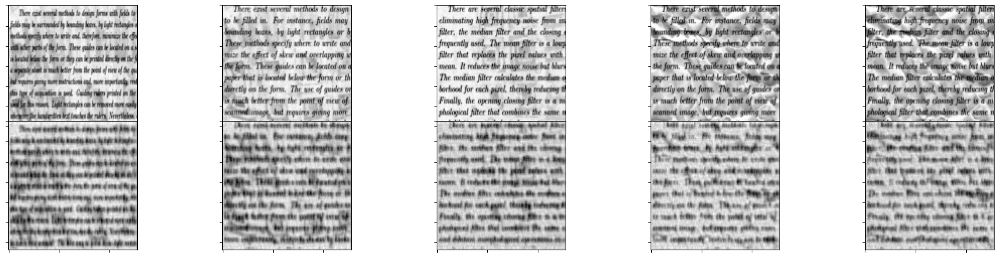


------------- Epoch 33 -------------
Epoch: 33 	Training Loss: 0.019665 	lr:0.043


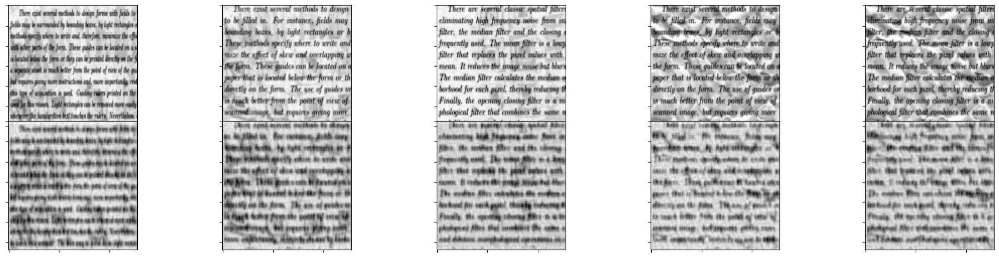


------------- Epoch 34 -------------
Epoch: 34 	Training Loss: 0.019595 	lr:0.037


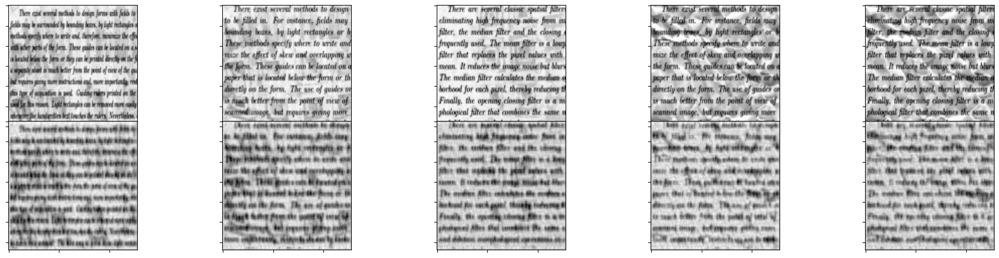


------------- Epoch 35 -------------
Epoch: 35 	Training Loss: 0.019506 	lr:0.043


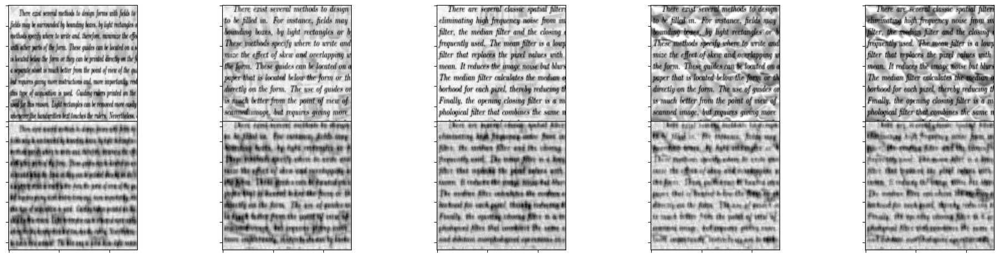


------------- Epoch 36 -------------
Epoch: 36 	Training Loss: 0.019438 	lr:0.037


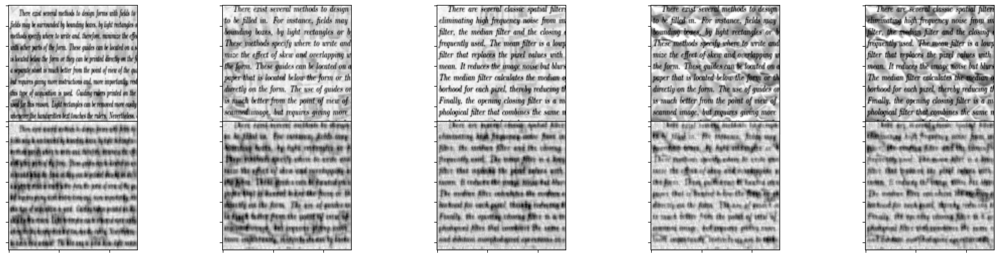


------------- Epoch 37 -------------
Epoch: 37 	Training Loss: 0.019355 	lr:0.043


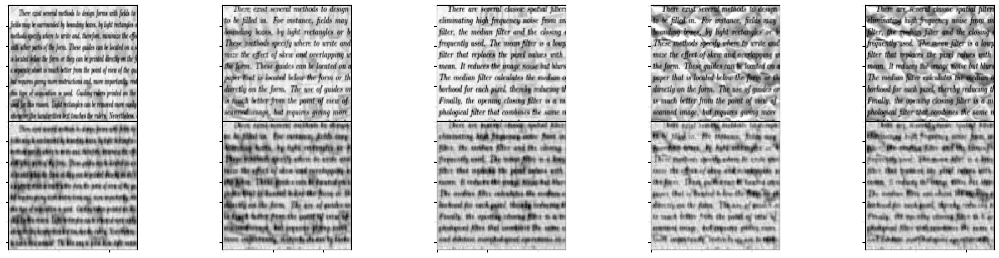


------------- Epoch 38 -------------
Epoch: 38 	Training Loss: 0.019289 	lr:0.037


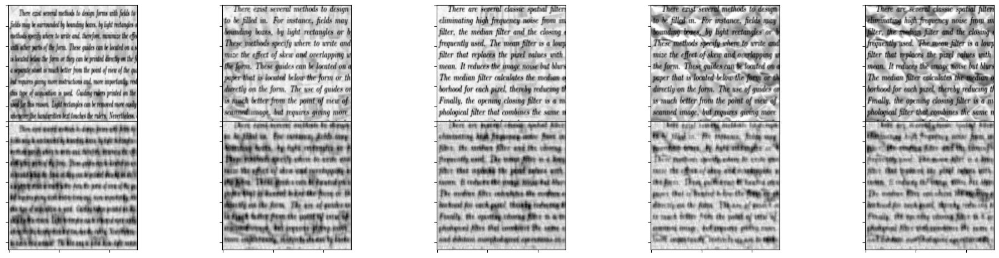


------------- Epoch 39 -------------
Epoch: 39 	Training Loss: 0.019205 	lr:0.043


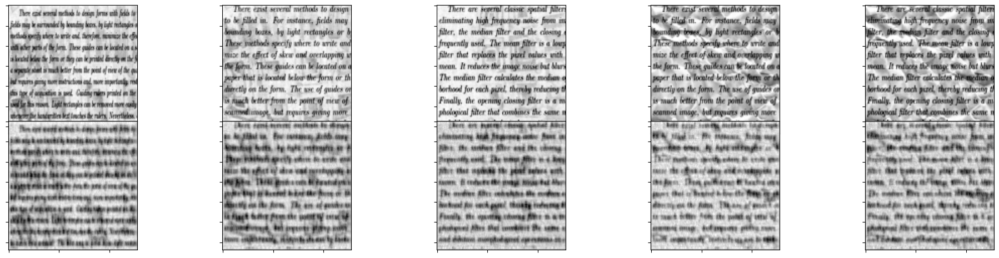


------------- Epoch 40 -------------
Epoch: 40 	Training Loss: 0.019141 	lr:0.037


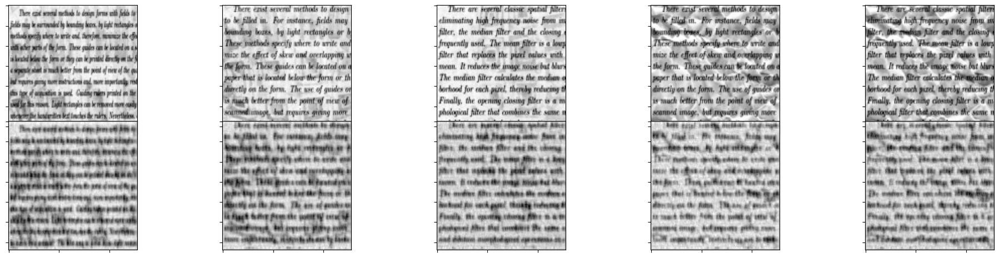


------------- Epoch 41 -------------
Epoch: 41 	Training Loss: 0.019060 	lr:0.043


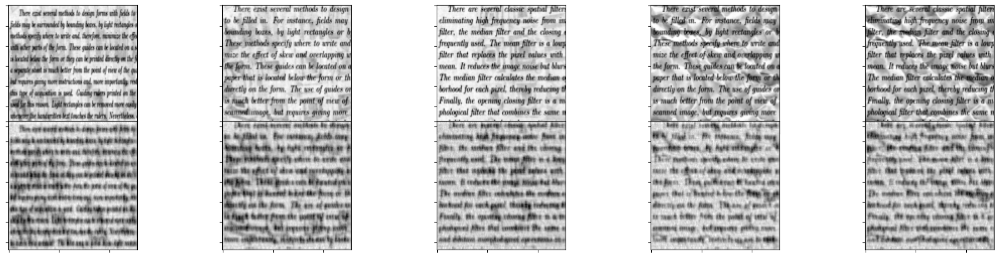


------------- Epoch 42 -------------
Epoch: 42 	Training Loss: 0.018997 	lr:0.037


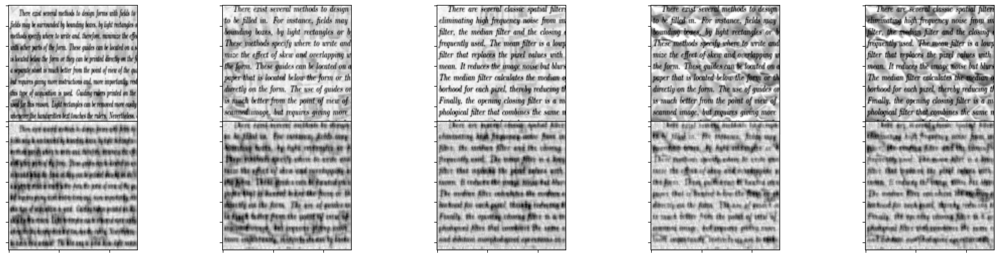


------------- Epoch 43 -------------
Epoch: 43 	Training Loss: 0.018916 	lr:0.043


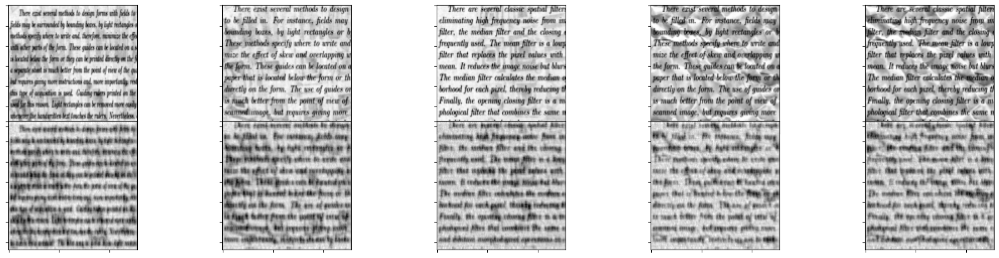


------------- Epoch 44 -------------
Epoch: 44 	Training Loss: 0.018856 	lr:0.037


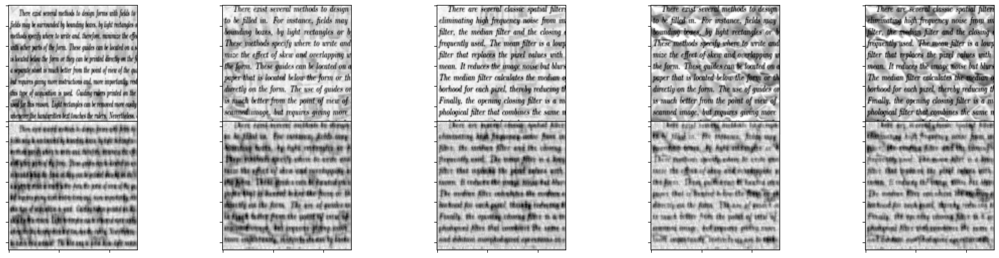


------------- Epoch 45 -------------
Epoch: 45 	Training Loss: 0.018777 	lr:0.043


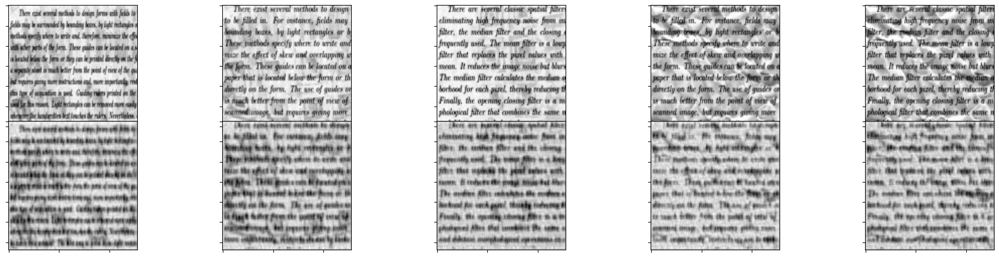


------------- Epoch 46 -------------
Epoch: 46 	Training Loss: 0.018719 	lr:0.037


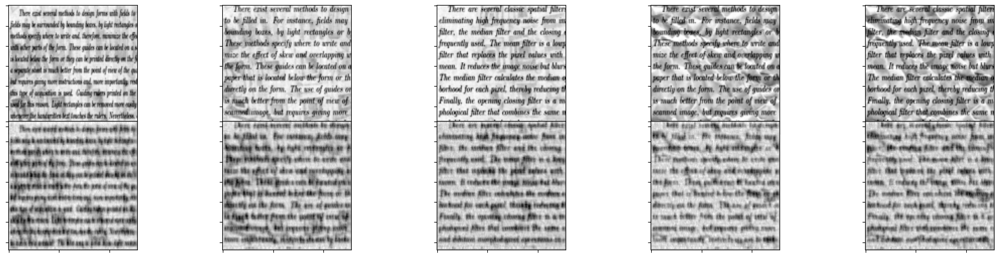


------------- Epoch 47 -------------
Epoch: 47 	Training Loss: 0.018642 	lr:0.043


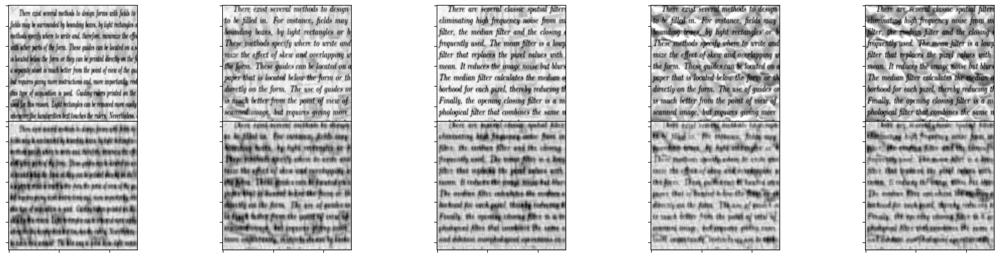


------------- Epoch 48 -------------
Epoch: 48 	Training Loss: 0.018585 	lr:0.037


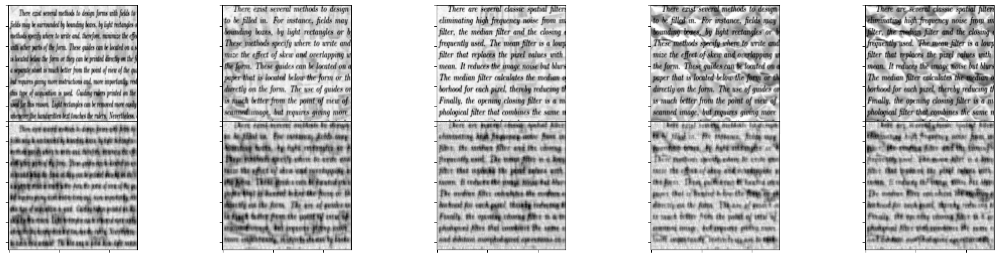


------------- Epoch 49 -------------
Epoch: 49 	Training Loss: 0.018508 	lr:0.043


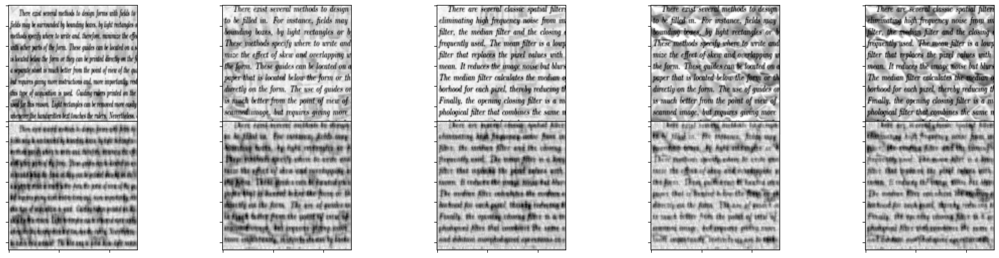


------------- Epoch 50 -------------
Epoch: 50 	Training Loss: 0.018451 	lr:0.037


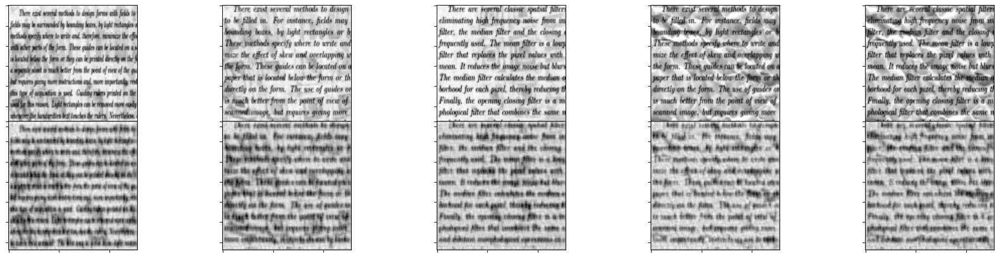


   --- Time execution ---
--- 5 minutes ---
 2


In [113]:
start_time = time.time()
n_epochs = 50
train_loss=[]
lrs = []
for epoch in range(1, n_epochs+1):
    print(f'\n{"-"*13} Epoch {epoch} {"-"*13}')

    train_loss_batch = 0.0
    model.train()
    for i, (data, _) in enumerate(loader):
        optimizer.zero_grad()        
        outputs = model(data.to(device))    
        loss = criterion(outputs, data.to(device))
        loss.backward()
        optimizer.step()
        lr_sched.step()
        train_loss_batch += loss.item()
    train_loss.append(train_loss_batch/len(loader))

    if epoch % 1 == 0:
        lrs.append(optimizer.param_groups[0]["lr"])
        print(f'Epoch: {epoch} \tTraining Loss: {train_loss_batch:.6f} \tlr:{optimizer.param_groups[0]["lr"]:.3f}')

        save_image(outputs.data[0].detach().cpu(), f'./data/results/img{epoch}.jpg')
        fig, ax = plt.subplots(2, 5, figsize=(20, 5))
        fig.tight_layout()
        ax = ax.flatten()
        for pos in range(10):
            if pos < 5:
                ax[pos].imshow(torch.permute(data.data[pos].detach().cpu(), (1, 2, 0)), cmap='gray')
                ax[pos].set_yticklabels([]); ax[pos].set_xticklabels([])
            else:
                ax[pos].imshow(torch.permute(outputs.data[pos-5].detach().cpu(), (1, 2, 0)), cmap='gray')
                ax[pos].set_yticklabels([]); ax[pos].set_xticklabels([])
        plt.subplots_adjust(wspace=0, hspace=-.1)
        plt.show()


print("\n   --- Time execution ---" )
print("--- %s minutes ---\n" % round(((time.time() - start_time)/60)), 2)

In [ ]:
# plot loss and metric code

11. Сделай предсказания на тестовой выборке. 

In [ ]:
# code

12. Заполни файл с предсказаниями в соответствии с требованиями: https://www.kaggle.com/c/denoising-dirty-documents/overview/evaluation

In [ ]:
# code

13. Загрузи результат на `kaggle`: 
- https://www.kaggle.com/c/denoising-dirty-documents/submit
- `kaggle competitions submit -c denoising-dirty-documents -f submission.csv -m "Message"`

In [2]:
# code